## <center>**Práctica 2**</center>
### <center>**Segmentación de carreteras**</center>
#### <center>Procesamiento de Imagen, Vídeo y Audio</center>
#### <center>_Carlos Hermida Mayán_</center>

In [1]:
import skimage.io as io
from skimage.color import rgb2gray, rgb2lab, rgb2hsv
from skimage import morphology
from utils_roads import XGBModel, splitter, get_metrics, plot_approach_result, plot_all_approaches, metrics_table
import numpy as np
import matplotlib.pyplot as plt
import scipy.ndimage as ndi

In [2]:
# plt.rcdefaults()
plt.rc('figure', facecolor=(0.16, 0.17, 0.2))
plt.rc('axes', facecolor=(0.16, 0.17, 0.2), edgecolor='white', labelcolor='white', titlecolor='white')
plt.rc('axes.spines', right=False, top=False)
plt.rc('xtick', color = 'white')
plt.rc('ytick', color = 'white')
plt.rc('legend', labelcolor = 'white')

In [3]:
SEED = 42
summary = dict()
sat = np.array(io.imread_collection('/Users/carloshermida/Documents/Data/Python/UDC/2023-2024/PIVA/P2/roads/sat/*.tiff'))
gt = np.array(io.imread_collection('/Users/carloshermida/Documents/Data/Python/UDC/2023-2024/PIVA/P2/roads/gt/*.tif'))

### <center>**---> BASELINE <---**</center>

#### Preprocesado

Entrada: Imágenes en escala de gris y aplanadas \
Salida: Imágenes booleanas aplanadas

##### Entrada

In [4]:
pre = rgb2gray(sat).reshape(20, -1)
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000)


##### Salida

In [5]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

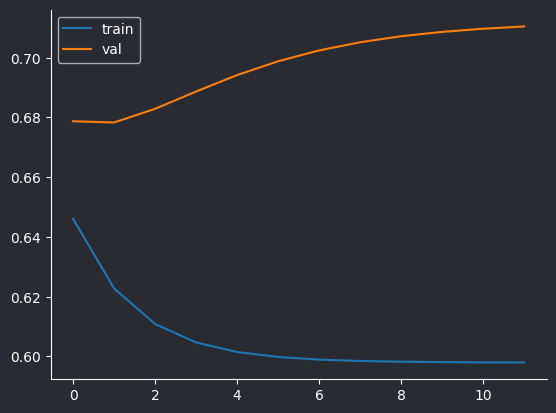

In [6]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['baseline'] = dict()
summary['baseline']['cycles'] = cycles
summary['baseline']['duration'] = duration

#### Predicción

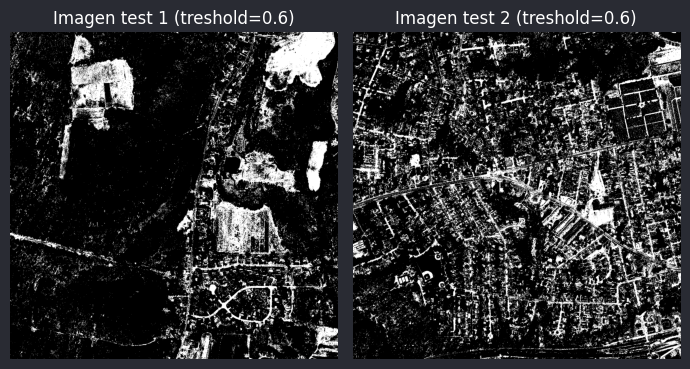

In [7]:
treshold = 0.6
summary['baseline']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

No se realiza postprocesado

In [8]:
post = prediction
summary['baseline']['image'] = post

#### Resultado

In [9]:
metrics = get_metrics(y_test, post.flatten())
summary['baseline']['metrics'] = metrics

In [10]:
print(metrics)

{'accuracy': 0.8123, 'precision': 0.1316, 'recall': 0.469, 'f1': 0.2055, 'jaccard': 0.1145}


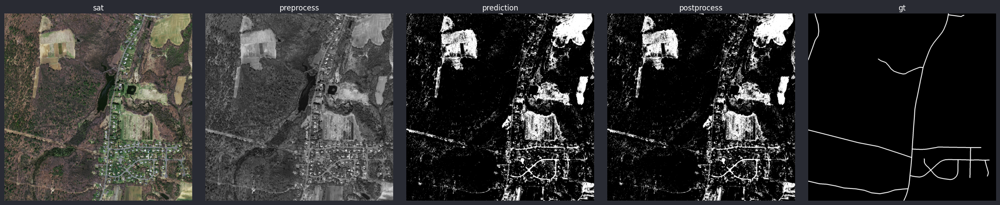

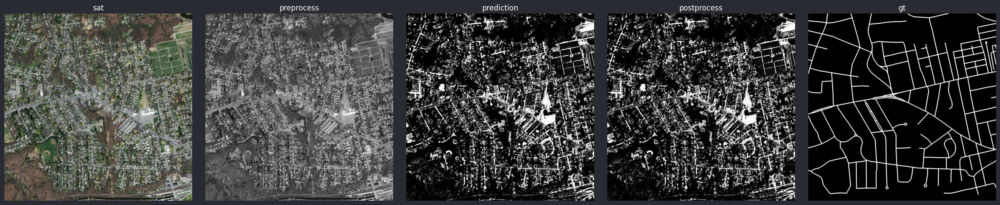

In [11]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> APROACH 1 <---**</center>

#### Preprocesado

Entrada: Imágenes en color y aplanadas \
Salida: Imágenes booleanas aplanadas

##### Entrada

In [12]:
pre = sat.reshape(20, 1500*1500, 3)
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000, 3)


##### Salida

In [13]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

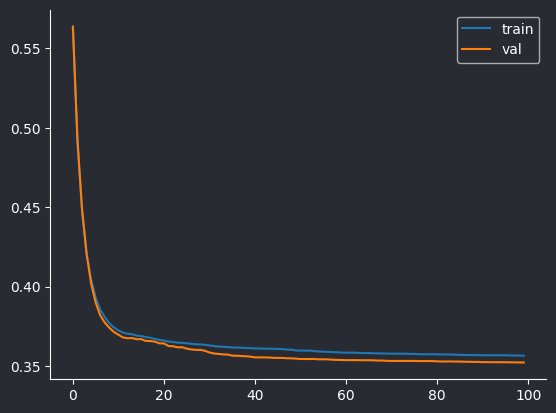

In [14]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['aproach_1 (RGB)'] = dict()
summary['aproach_1 (RGB)']['cycles'] = cycles
summary['aproach_1 (RGB)']['duration'] = duration

#### Predicción

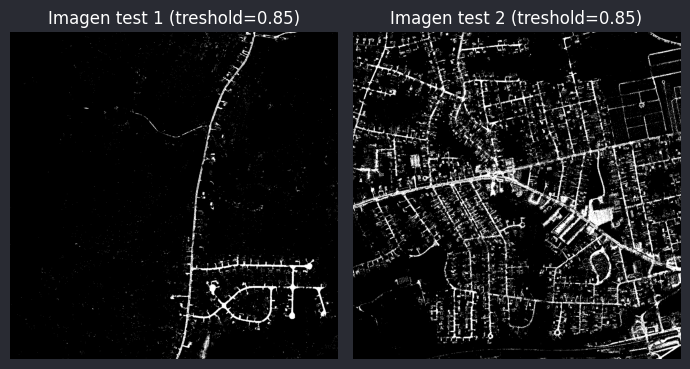

In [15]:
treshold = 0.85
summary['aproach_1 (RGB)']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

No se realiza postprocesado

In [16]:
post = prediction
summary['aproach_1 (RGB)']['image'] = post

#### Resultado

In [17]:
metrics = get_metrics(y_test, post.flatten())
summary['aproach_1 (RGB)']['metrics'] = metrics

In [18]:
print(metrics)

{'accuracy': 0.9241, 'precision': 0.3521, 'recall': 0.5544, 'f1': 0.4306, 'jaccard': 0.2744}


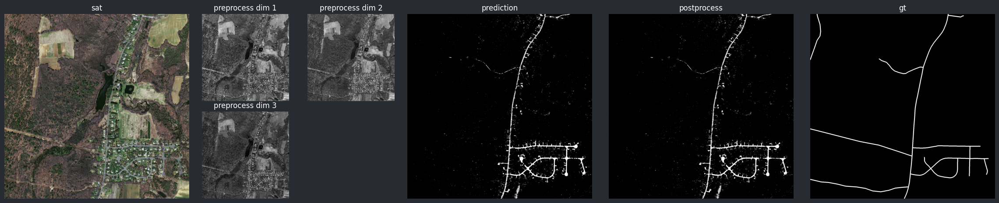

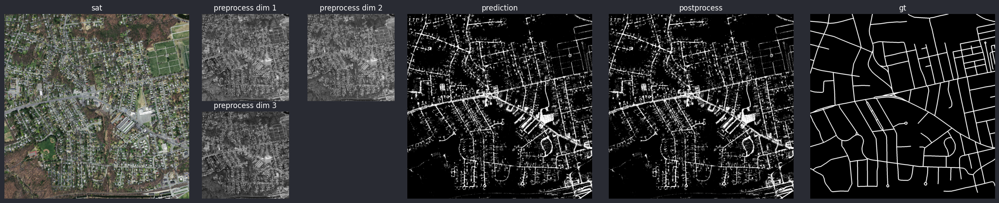

In [19]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> APROACH 2 <---**</center>

#### Preprocesado

Entrada: canal saturación de *HSV* y canal b de *Lab*  para cada imagen aplanada \
Salida: Imágenes booleanas aplanadas

##### Entrada

Para un caso en concreto:

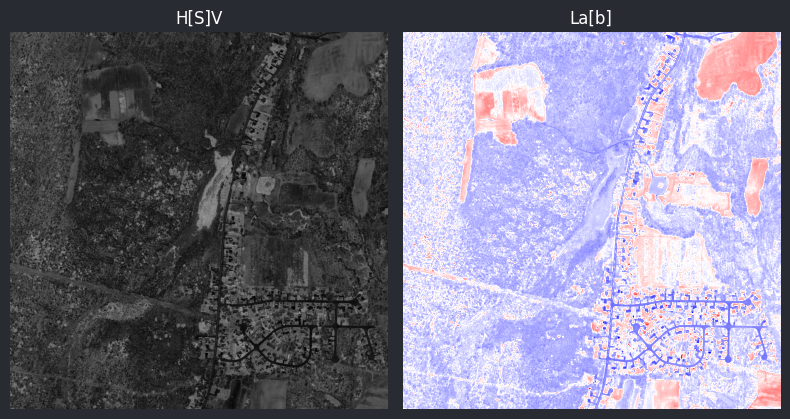

In [20]:
img_hsv = rgb2hsv(sat[0])
img_lab = rgb2lab(sat[0])

fig, axs = plt.subplots(1, 2, figsize=(8, 8))

axs[0].imshow(img_hsv[:,:,1], cmap = 'gray')
axs[0].set_title('H[S]V')
axs[0].axis("off")

axs[1].imshow(img_lab[:,:,2], cmap = 'seismic')
axs[1].set_title('La[b]')
axs[1].axis("off")

plt.tight_layout()
plt.show()

Generalización:

In [21]:
pre = np.array(list(map(lambda x: np.column_stack((rgb2hsv(x)[:,:,1].flatten(), rgb2lab(x)[:,:,2].flatten())), sat)))
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000, 2)


##### Salida

In [22]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

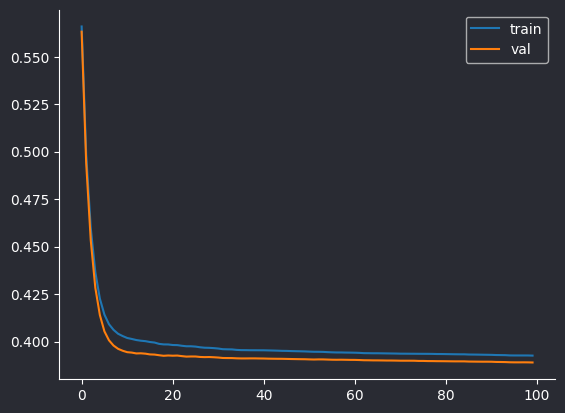

In [23]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['aproach_2 (H[S]V + La[b])'] = dict()
summary['aproach_2 (H[S]V + La[b])']['cycles'] = cycles
summary['aproach_2 (H[S]V + La[b])']['duration'] = duration

#### Predicción

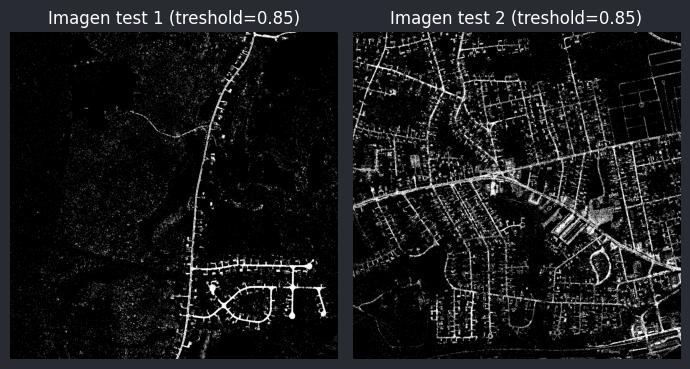

In [24]:
treshold = 0.85
summary['aproach_2 (H[S]V + La[b])']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

No se realiza postprocesado

In [25]:
post = prediction
summary['aproach_2 (H[S]V + La[b])']['image'] = post

#### Resultado

In [26]:
metrics = get_metrics(y_test, post.flatten())
summary['aproach_2 (H[S]V + La[b])']['metrics'] = metrics

In [27]:
print(metrics)

{'accuracy': 0.9161, 'precision': 0.3015, 'recall': 0.472, 'f1': 0.368, 'jaccard': 0.2255}


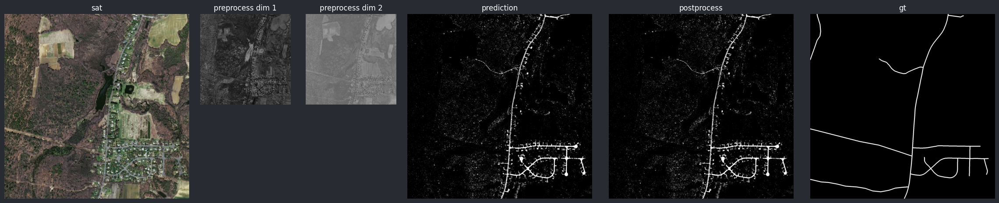

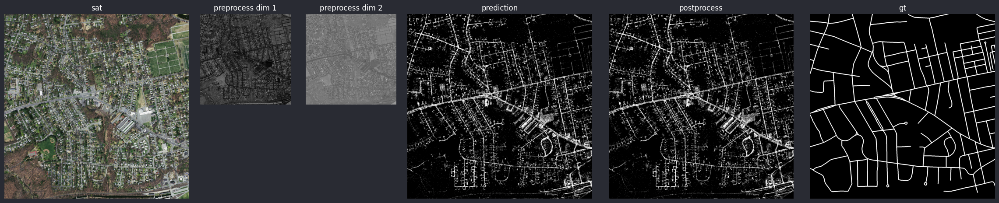

In [28]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> APROACH 3 <---**</center>

#### Preprocesado

Entrada: Imágenes en color y laplaciano del canal saturación de las imágenes en HSV, aplanados \
Salida: Imágenes booleanas aplanadas

##### Entrada

Para un caso concreto:

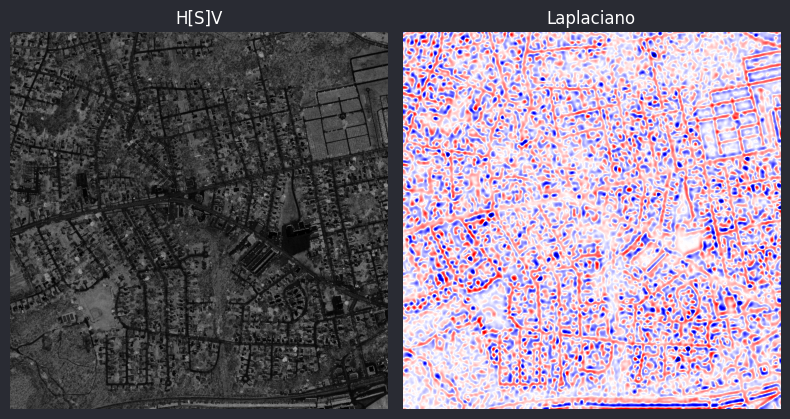

In [29]:
img_s = rgb2hsv(sat[17])[:,:,1]

gaussian_v = ndi.gaussian_filter(img_s, sigma=7, order=[2, 0])
gaussian_h = ndi.gaussian_filter(img_s, sigma=7, order=[0, 2])
laplacian = gaussian_v + gaussian_h

fig, axs = plt.subplots(1, 2, figsize=(8, 8))

axs[0].imshow(img_s, cmap = 'gray')
axs[0].set_title('H[S]V')
axs[0].axis("off")

axs[1].imshow(laplacian, cmap = 'seismic', vmin=-0.005, vmax=0.005)
axs[1].set_title('Laplaciano')
axs[1].axis("off")

plt.tight_layout()
plt.show()

Generalización:

In [30]:
operation = lambda x: (ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[2, 0]) + ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[0, 2])).flatten()
edges = np.array(list(map(operation, sat)))
pre = np.concatenate((sat.reshape(20, 1500*1500, 3), edges[:, :, np.newaxis]), axis=2)
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000, 4)


##### Salida

In [31]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

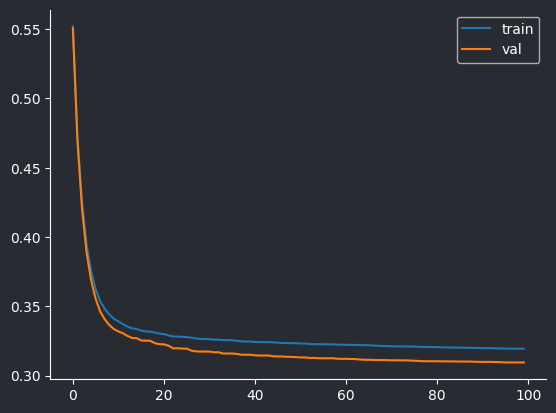

In [32]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['aproach_3 (RGB + laplace(H[S]V))'] = dict()
summary['aproach_3 (RGB + laplace(H[S]V))']['cycles'] = cycles
summary['aproach_3 (RGB + laplace(H[S]V))']['duration'] = duration

#### Predicción

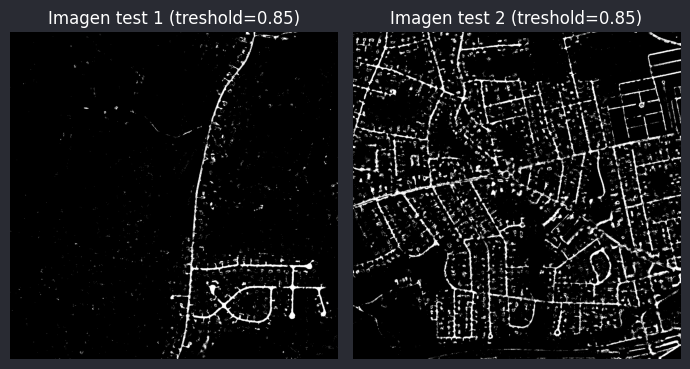

In [33]:
treshold = 0.85
summary['aproach_3 (RGB + laplace(H[S]V))']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

No se realiza postprocesado

In [34]:
post = prediction
summary['aproach_3 (RGB + laplace(H[S]V))']['image'] = post

#### Resultado

In [35]:
metrics = get_metrics(y_test, post.flatten())
summary['aproach_3 (RGB + laplace(H[S]V))']['metrics'] = metrics

In [36]:
print(metrics)

{'accuracy': 0.9379, 'precision': 0.4259, 'recall': 0.5712, 'f1': 0.488, 'jaccard': 0.3227}


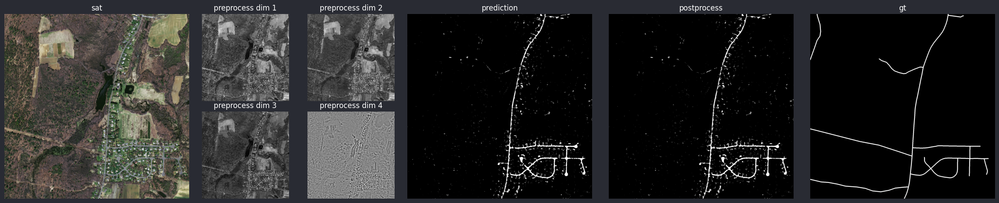

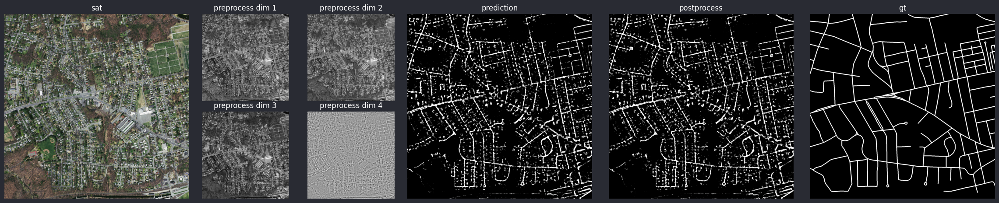

In [37]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> APROACH 4 <---**</center>

#### Preprocesado

Entrada: Imágenes en color y laplaciano del canal saturación de las imágenes en HSV, aplanados \
Salida: Imágenes booleanas aplanadas

##### Entrada

Para un caso concreto:

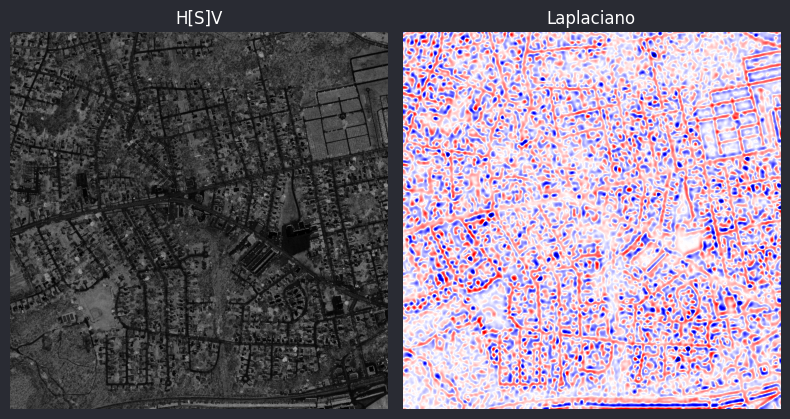

In [38]:
img_s = rgb2hsv(sat[17])[:,:,1]

gaussian_v = ndi.gaussian_filter(img_s, sigma=7, order=[2, 0])
gaussian_h = ndi.gaussian_filter(img_s, sigma=7, order=[0, 2])
laplacian = gaussian_v + gaussian_h

fig, axs = plt.subplots(1, 2, figsize=(8, 8))

axs[0].imshow(img_s, cmap = 'gray')
axs[0].set_title('H[S]V')
axs[0].axis("off")

axs[1].imshow(laplacian, cmap = 'seismic', vmin=-0.005, vmax=0.005)
axs[1].set_title('Laplaciano')
axs[1].axis("off")

plt.tight_layout()
plt.show()

Generalización:

In [39]:
operation = lambda x: (ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[2, 0]) + ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[0, 2])).flatten()
edges = np.array(list(map(operation, sat)))
pre = np.concatenate((sat.reshape(20, 1500*1500, 3), edges[:, :, np.newaxis]), axis=2)
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000, 4)


##### Salida

In [40]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

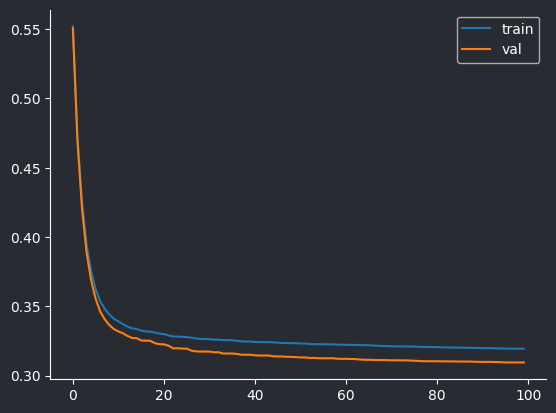

In [41]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['aproach_4 (RGB + laplace(H[S]V) + median_filter)'] = dict()
summary['aproach_4 (RGB + laplace(H[S]V) + median_filter)']['cycles'] = cycles
summary['aproach_4 (RGB + laplace(H[S]V) + median_filter)']['duration'] = duration

#### Predicción

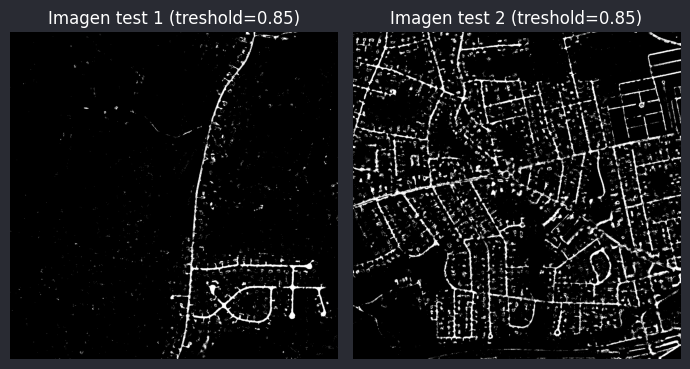

In [42]:
treshold = 0.85
summary['aproach_4 (RGB + laplace(H[S]V) + median_filter)']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

Se refina la salida predicha con un filtro de mediana, puesto que se comprobó \
en la anterior práctica que funciona bien con ruido de tipo sal y pimienta.

Para un caso concreto:

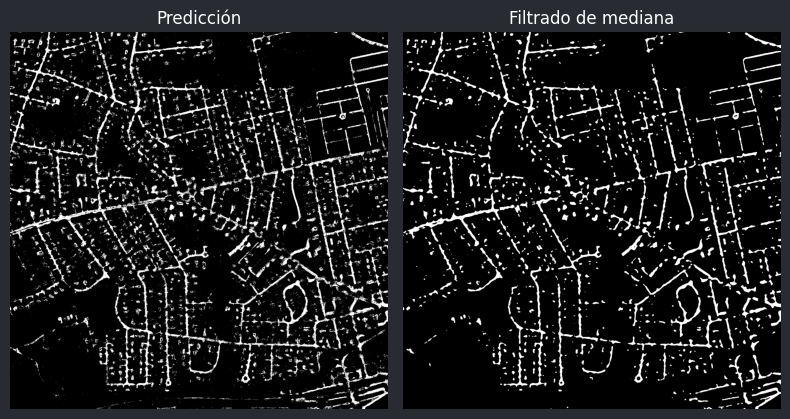

In [43]:
prediction1 = prediction[1].reshape(1500,1500)
result = ndi.median_filter(prediction1, size=7)

fig, axs = plt.subplots(1, 2, figsize=(8, 8))

axs[0].imshow(prediction1, cmap = 'gray')
axs[0].set_title('Predicción')
axs[0].axis("off")

axs[1].imshow(result, cmap = 'gray')
axs[1].set_title('Filtrado de mediana')
axs[1].axis("off")

plt.tight_layout()
plt.show()

Generalización:

In [44]:
operation = lambda x: (ndi.median_filter(x.reshape(1500,1500), size=7)).flatten()

post = np.array(list(map(operation, prediction)))
summary['aproach_4 (RGB + laplace(H[S]V) + median_filter)']['image'] = post

#### Resultado

In [45]:
metrics = get_metrics(y_test, post.flatten())
summary['aproach_4 (RGB + laplace(H[S]V) + median_filter)']['metrics'] = metrics

In [46]:
print(metrics)

{'accuracy': 0.9504, 'precision': 0.5197, 'recall': 0.5493, 'f1': 0.5341, 'jaccard': 0.3643}


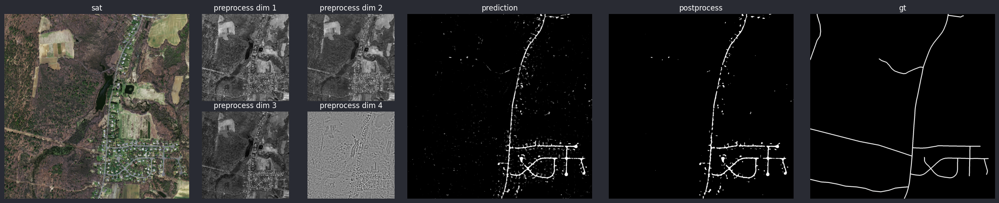

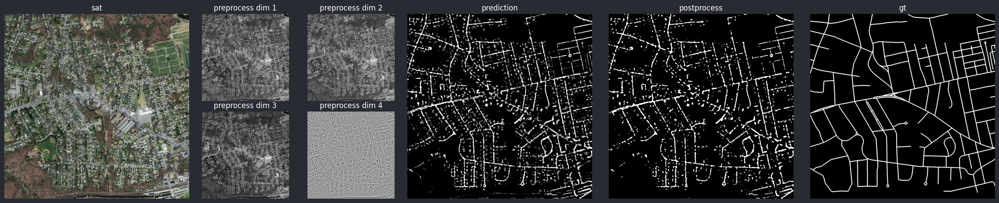

In [47]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> APROACH 5 <---**</center>

#### Preprocesado

Entrada: Imágenes en color y laplaciano del canal saturación de las imágenes en HSV, aplanados \
Salida: Imágenes booleanas aplanadas

##### Entrada

Para un caso concreto:

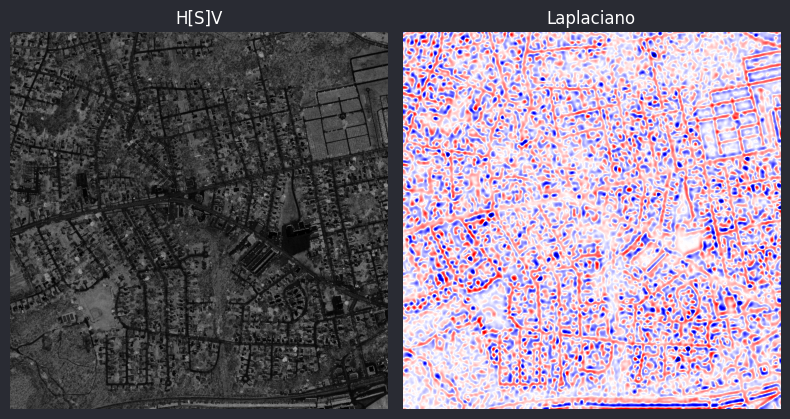

In [48]:
img_s = rgb2hsv(sat[17])[:,:,1]

gaussian_v = ndi.gaussian_filter(img_s, sigma=7, order=[2, 0])
gaussian_h = ndi.gaussian_filter(img_s, sigma=7, order=[0, 2])
laplacian = gaussian_v + gaussian_h

fig, axs = plt.subplots(1, 2, figsize=(8, 8))

axs[0].imshow(img_s, cmap = 'gray')
axs[0].set_title('H[S]V')
axs[0].axis("off")

axs[1].imshow(laplacian, cmap = 'seismic', vmin=-0.005, vmax=0.005)
axs[1].set_title('Laplaciano')
axs[1].axis("off")

plt.tight_layout()
plt.show()

Generalización:

In [49]:
operation = lambda x: (ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[2, 0]) + ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[0, 2])).flatten()
edges = np.array(list(map(operation, sat)))
pre = np.concatenate((sat.reshape(20, 1500*1500, 3), edges[:, :, np.newaxis]), axis=2)
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000, 4)


##### Salida

In [50]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

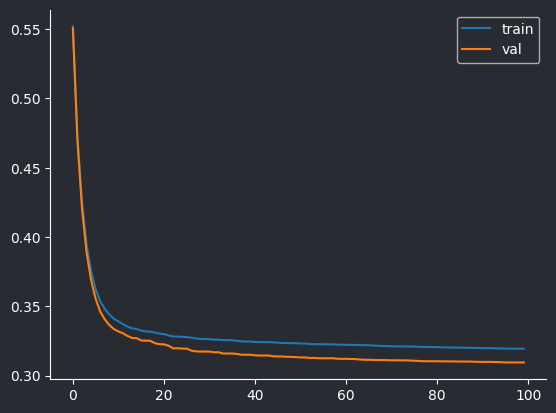

In [51]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['aproach_5 (RGB + laplace(H[S]V) + morph)'] = dict()
summary['aproach_5 (RGB + laplace(H[S]V) + morph)']['cycles'] = cycles
summary['aproach_5 (RGB + laplace(H[S]V) + morph)']['duration'] = duration

#### Predicción

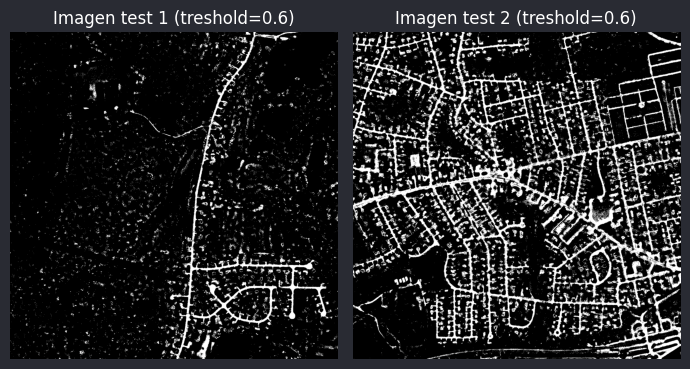

In [52]:
treshold = 0.6
summary['aproach_5 (RGB + laplace(H[S]V) + morph)']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

Se refina la salida predicha con aperturas con operadores morfológicos rectangulares. \
En primer lugar, se aplica una erosión para quedarnos con los elementos rectangulares como las carreteras, \
y a través de una dilatación se recupera su tamaño. Se utiliza la apertura tanto horizontal como verticalmente, \
y se combinan ambas salidas para el resultado final.

Para un caso en concreto:

In [53]:
prediction1 = prediction[1].reshape(1500, 1500)

rect_h = morphology.rectangle(1,15)
rect_v = morphology.rectangle(15,1)

erosion_h = morphology.erosion(prediction1, rect_h)
dilation_h = morphology.dilation(erosion_h, rect_h)

erosion_v = morphology.erosion(prediction1, rect_v)
dilation_v = morphology.dilation(erosion_v, rect_v)

result = ((dilation_h + dilation_v) >= 1).astype('int')

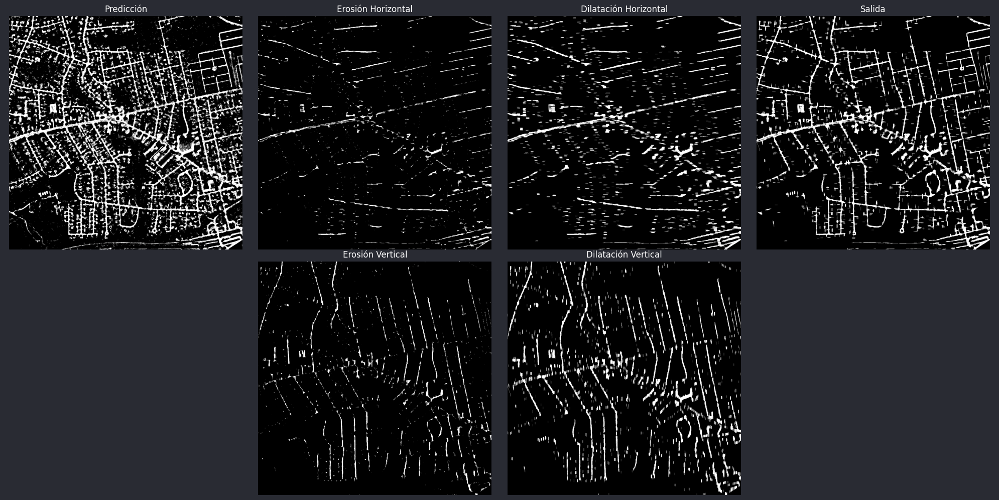

In [54]:
fig, axs = plt.subplots(2, 4, figsize=(20, 10))

axs[0, 0].imshow(prediction1, cmap='gray')
axs[0, 0].set_title('Predicción')
axs[0, 0].axis("off")

axs[0, 1].imshow(erosion_h, cmap='gray')
axs[0, 1].set_title('Erosión Horizontal')
axs[0, 1].axis("off")

axs[0, 2].imshow(dilation_h, cmap='gray')
axs[0, 2].set_title('Dilatación Horizontal')
axs[0, 2].axis("off")

axs[1, 1].imshow(erosion_v, cmap='gray')
axs[1, 1].set_title('Erosión Vertical')
axs[1, 1].axis("off")

axs[1, 2].imshow(dilation_v, cmap='gray')
axs[1, 2].set_title('Dilatación Vertical')
axs[1, 2].axis("off")

axs[0, 3].imshow(result, cmap='gray')
axs[0, 3].set_title('Salida')
axs[0, 3].axis("off")


axs[1, 0].axis("off")
axs[1, 3].axis("off")
plt.tight_layout()
plt.show()

Generalización:

In [55]:
rect_h = morphology.rectangle(1,15)
rect_v = morphology.rectangle(15,1)

operation = lambda x: ((morphology.opening(x.reshape(1500, 1500), rect_h) + morphology.opening(x.reshape(1500, 1500), rect_v)) >= 1).astype('int').flatten()
post = np.array(list(map(operation, prediction)))
summary['aproach_5 (RGB + laplace(H[S]V) + morph)']['image'] = post

#### Resultado

In [56]:
metrics = get_metrics(y_test, post.flatten())
summary['aproach_5 (RGB + laplace(H[S]V) + morph)']['metrics'] = metrics

In [57]:
print(metrics)

{'accuracy': 0.9426, 'precision': 0.4613, 'recall': 0.653, 'f1': 0.5407, 'jaccard': 0.3705}


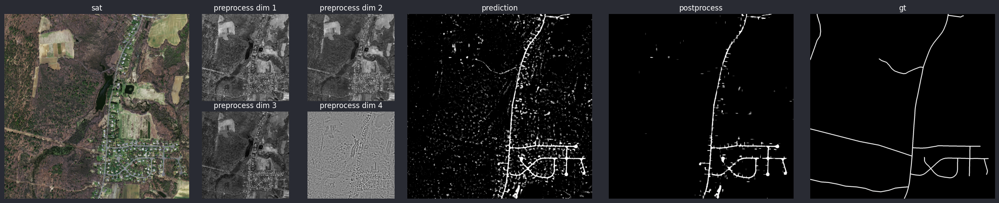

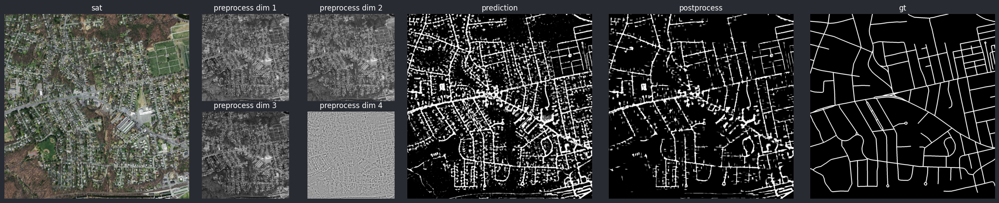

In [58]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> COMBINATION <---**</center>

#### Preprocesado

Entrada:
- Escala de gris
- Canales RGB
- Canal saturación de *HSV* y canal b de *Lab*
- Laplaciano del canal saturación de *HSV*

Salida: Imágenes booleanas aplanadas

##### Entrada

In [59]:
gray = rgb2gray(sat).reshape(20, -1)[:, :, np.newaxis]

rgb = sat.reshape(20, 1500*1500, 3)

sb = np.array(list(map(lambda x: np.column_stack((rgb2hsv(x)[:,:,1].flatten(), rgb2lab(x)[:,:,2].flatten())), sat)))

operation = lambda x: (ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[2, 0]) + ndi.gaussian_filter(rgb2hsv(x)[:,:,1], sigma=7, order=[0, 2])).flatten()
edges = np.array(list(map(operation, sat)))[:, :, np.newaxis]

In [60]:
pre = np.concatenate((gray, rgb, sb, edges), axis=2)
print("Preprocessed Inputs -->", pre.shape)

Preprocessed Inputs --> (20, 2250000, 7)


##### Salida

In [61]:
outputs = gt.reshape(20, -1).astype('bool').astype('int')
print("Outputs -->", outputs.shape)

Outputs --> (20, 2250000)


#### Entrenamiento

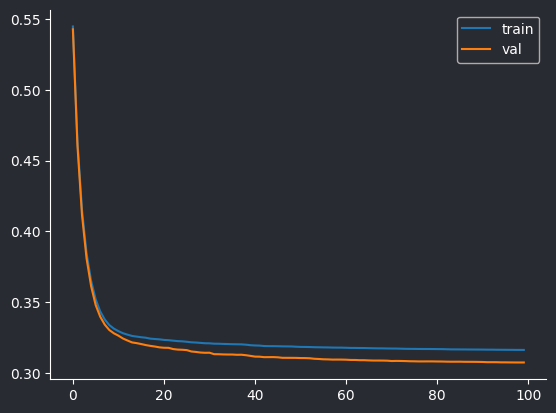

In [62]:
X_train, y_train, X_val, y_val, X_test, y_test, sample_weights, test_indices = splitter(pre, outputs, random_state=SEED)

model = XGBModel()
cycles, duration = model.train(X_train, y_train, X_val, y_val, sample_weights)

summary['combination'] = dict()
summary['combination']['cycles'] = cycles
summary['combination']['duration'] = duration

#### Predicción

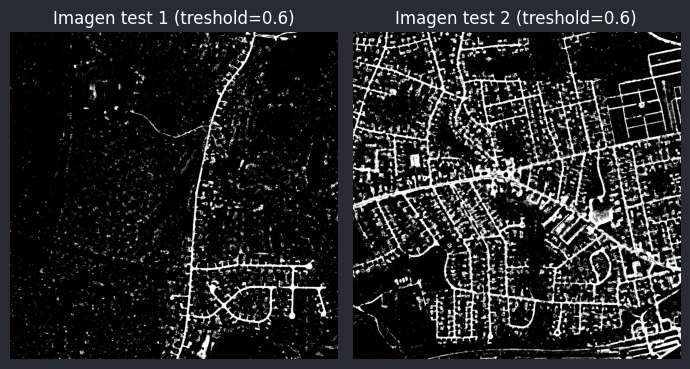

In [63]:
treshold = 0.6
summary['combination']['treshold'] = treshold
prediction = model.predict(X_test, treshold)

#### Postprocesado

Primer paso: \
Se refina la salida predicha con aperturas con operadores morfológicos rectangulares. \
En primer lugar, se aplica una erosión para quedarnos con los elementos rectangulares como las carreteras, \
y a través de una dilatación se recupera su tamaño. Se utiliza la apertura tanto horizontal como verticalmente, \
y se combinan ambas salidas para el resultado final. \
\
Segundo paso: \
Se limpia el resultado anterior con un filtro de mediana, puesto que se comprobó \
en la anterior práctica que funciona bien con ruido de tipo sal y pimienta.



Operadores Morfológicos:

In [64]:
rect_h = morphology.rectangle(1,15)
rect_v = morphology.rectangle(15,1)

morph_op = lambda x: ((morphology.opening(x.reshape(1500, 1500), rect_h) + morphology.opening(x.reshape(1500, 1500), rect_v)) >= 1).astype('int').flatten()
morph_result = np.array(list(map(morph_op, prediction)))

Filtrado de mediana:

In [65]:
filter_op = lambda x: (ndi.median_filter(x.reshape(1500,1500), size=7)).flatten()
post = np.array(list(map(filter_op, morph_result)))

summary['combination']['image'] = post

#### Resultado

In [66]:
metrics = get_metrics(y_test, post.flatten())
summary['combination']['metrics'] = metrics

In [67]:
print(metrics)

{'accuracy': 0.9505, 'precision': 0.5181, 'recall': 0.6341, 'f1': 0.5702, 'jaccard': 0.3988}


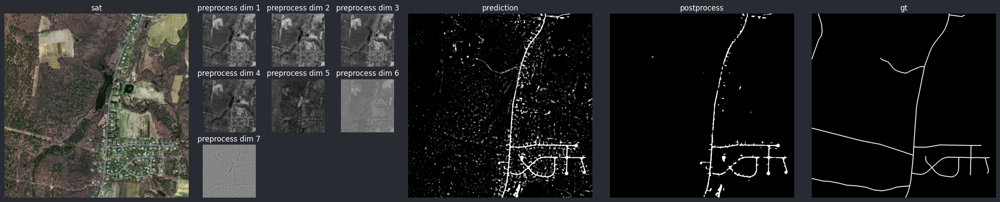

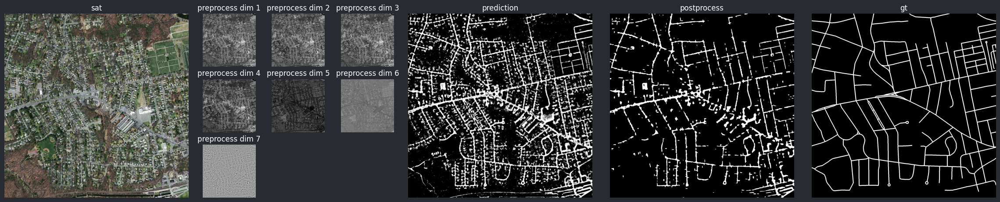

In [68]:
plot_approach_result(sat, pre, prediction, post, gt, test_indices)

### <center>**---> SUMMARY <---**</center>

In [69]:
display(metrics_table(summary))

,aproximación,ciclos,duración (s),treshold,accuracy,precision,recall,f1,jaccard
0,baseline,12,14.11,0.60,0.8123,0.1316,0.4690,0.2055,0.1145
1,aproach_1 (RGB),100,78.41,0.85,0.9241,0.3521,0.5544,0.4306,0.2744
2,aproach_2 (H[S]V + La[b]),100,76.41,0.85,0.9161,0.3015,0.4720,0.3680,0.2255
3,aproach_3 (RGB + laplace(H[S]V)),100,90.35,0.85,0.9379,0.4259,0.5712,0.4880,0.3227
4,aproach_4 (RGB + laplace(H[S]V) + median_filter),100,88.17,0.85,0.9504,0.5197,0.5493,0.5341,0.3643
5,aproach_5 (RGB + laplace(H[S]V) + morph),100,86.60,0.60,0.9426,0.4613,0.6530,0.5407,0.3705
6,combination,100,122.25,0.60,0.9505,0.5181,0.6341,0.5702,0.3988


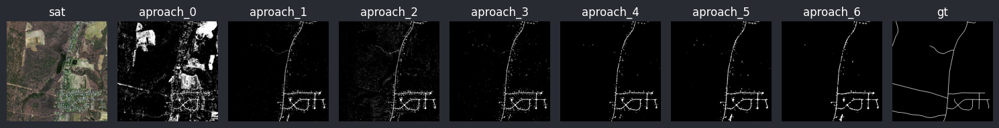

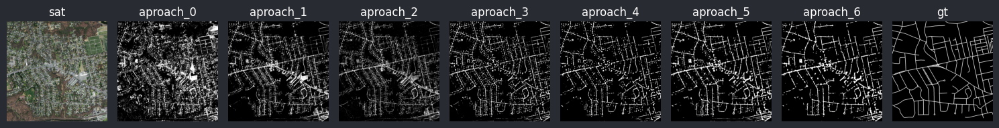

In [70]:
plot_all_approaches(sat, summary, gt, test_indices)